### **Descarga del dataset:**

In [ ]:
!pip install kaggle

In [ ]:
!kaggle datasets download -d alistairking/recyclable-and-household-waste-classification

Dataset URL: https://www.kaggle.com/datasets/alistairking/recyclable-and-household-waste-classification
License(s): MIT
 97% 896M/920M [00:10<00:01, 17.3MB/s]
100% 920M/920M [00:10<00:00, 88.1MB/s]


In [ ]:
import zipfile
import glob
import os
import shutil
import numpy as np

In [ ]:

with zipfile.ZipFile('recyclable-and-household-waste-classification.zip', 'r') as zip_ref:
    zip_ref.extractall()

In [ ]:
#!rm -rf images

In [ ]:
dataset_path = 'images/images'

Encontramos que el dataset está dividido por carpetas cuyo nombre vendría siendo la etiqueta de la imagen

In [ ]:
labels = os.listdir(dataset_path)

In [ ]:
labels= sorted(labels)

In [ ]:
labels

['aerosol_cans',
 'aluminum_food_cans',
 'aluminum_soda_cans',
 'cardboard_boxes',
 'cardboard_packaging',
 'clothing',
 'coffee_grounds',
 'disposable_plastic_cutlery',
 'eggshells',
 'food_waste',
 'glass_beverage_bottles',
 'glass_cosmetic_containers',
 'glass_food_jars',
 'magazines',
 'newspaper',
 'office_paper',
 'paper_cups',
 'plastic_cup_lids',
 'plastic_detergent_bottles',
 'plastic_food_containers',
 'plastic_shopping_bags',
 'plastic_soda_bottles',
 'plastic_straws',
 'plastic_trash_bags',
 'plastic_water_bottles',
 'shoes',
 'steel_food_cans',
 'styrofoam_cups',
 'styrofoam_food_containers',
 'tea_bags']

In [ ]:
type(labels)

list

In [ ]:
dataset_path

'images/images'

Dentro de cada categoria se encuentran dos carpetas: 'default' y 'real_world', lo que deseamos unir en uno solo

In [ ]:
import os
import glob
import numpy as np

# Definir el path base
base_path = 'images/images/'

# Inicializar listas para almacenar las rutas de las imágenes y las etiquetas
image_paths = []
labels = []

# Recorrer las carpetas de primer nivel (labels)
for label in os.listdir(base_path):
    label_path = os.path.join(base_path, label)

    if os.path.isdir(label_path):
        # Acceder a la carpeta 'default'
        default_path = os.path.join(label_path, 'default')
        if os.path.exists(default_path):
            for img_path in glob.glob(os.path.join(default_path, '*')):
                image_paths.append(img_path)
                labels.append(label)  # Guardar la etiqueta

        # Acceder a la carpeta 'real_world'
        real_world_path = os.path.join(label_path, 'real_world')
        if os.path.exists(real_world_path):
            for img_path in glob.glob(os.path.join(real_world_path, '*')):
                image_paths.append(img_path)
                labels.append(label)  # Guardar la etiqueta

# Convertir las listas a numpy arrays para conveniencia
x = np.array(image_paths)
y = np.array(labels)

# Mostrar las etiquetas y las rutas de las imágenes (opcional)
#for i in range(len(x)):
    #print(f'Imagen: {x[i]}, Etiqueta: {y[i]}')


In [ ]:
len(image_paths)

15000

Visualización de la distribución de imágenes por etiqueta

Text(0, 0.5, 'Cantidad')

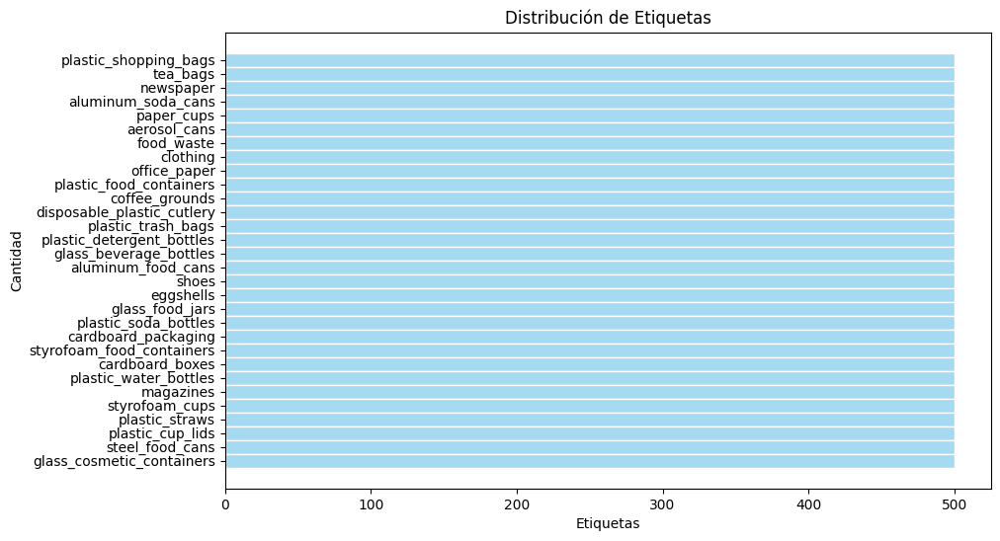

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.histplot(y=y, color='skyblue', edgecolor='white')
plt.title('Distribución de Etiquetas')
plt.xlabel('Etiquetas')
plt.ylabel('Cantidad')

In [ ]:
x

array(['images/images/clothing/default/Image_122.png',
       'images/images/clothing/default/Image_94.png',
       'images/images/clothing/default/Image_196.png', ...,
       'images/images/plastic_straws/real_world/Image_11.png',
       'images/images/plastic_straws/real_world/Image_243.png',
       'images/images/plastic_straws/real_world/Image_34.png'],
      dtype='<U65')

In [ ]:
y

array(['clothing', 'clothing', 'clothing', ..., 'plastic_straws',
       'plastic_straws', 'plastic_straws'], dtype='<U26')

In [ ]:
import cv2

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [ ]:
mpimg.imread(x[0]).shape

(256, 256, 3)

### **Visualizando las posibles futuras modificaciones de las imagenes:**

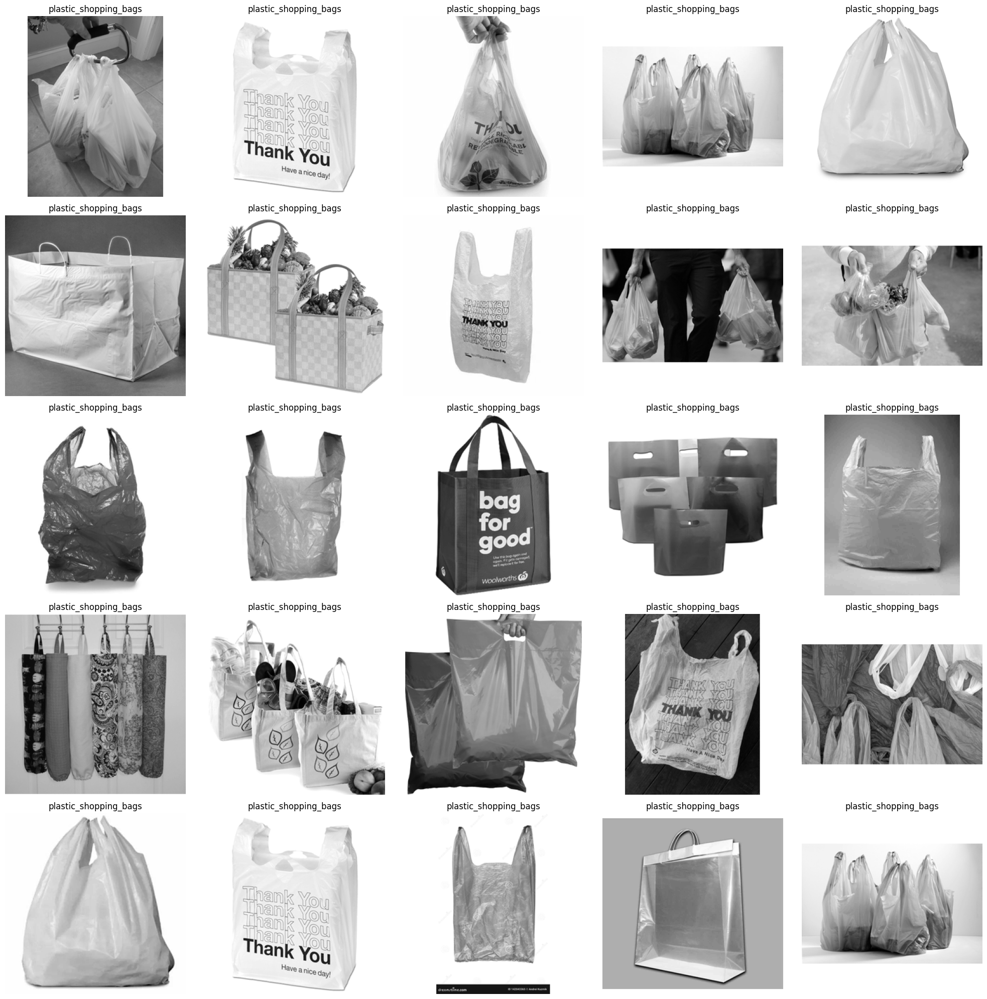

In [ ]:


# Definir el tamaño de la figura
plt.figure(figsize=(20, 20))

# Definir cuántas imágenes quieres mostrar (en este caso, 25 o menos)
num_images = min(len(image_paths), 25)

image_size=256

# Mostrar las imágenes
for i in range(num_images):
    imagen = mpimg.imread(image_paths[i])  # Leer la imagen desde la ruta
    etiqueta = labels[i]  # Obtener la etiqueta correspondiente

    plt.subplot(5, 5, i+1)
    imagen=cv2.resize(imagen, (image_size, image_size))#redimensionando la imagen
    imagen=cv2.cvtColor(imagen, cv2.COLOR_RGB2GRAY)#cambiando a escala de grises
    plt.imshow(imagen, cmap='gray')
    plt.title(etiqueta)  # Mostrar la etiqueta como título
    plt.axis('off')  # Ocultar los ejes

plt.tight_layout()
plt.show()


### **Aplicando las modificaciones realmente (redimensión de las imagenes y escala de grises)**

In [ ]:
train_set=[]

In [ ]:
num_images1=len(image_paths)

In [ ]:
image_size=100

In [ ]:
for i in range(num_images1):
    imagen = mpimg.imread(image_paths[i])  # Leer la imagen desde la ruta
    etiqueta = labels[i]  # Obtener la etiqueta correspondiente

    imagen=cv2.resize(imagen, (image_size, image_size))#redimensionando la imagen
    imagen=cv2.cvtColor(imagen, cv2.COLOR_RGB2GRAY)#cambiando a escala de grises
    imagen= imagen.reshape(image_size,image_size,1)

    train_set.append([imagen,etiqueta])

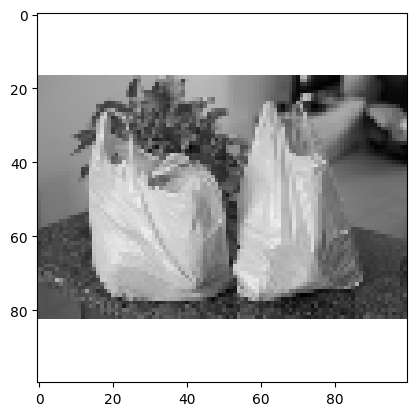

In [ ]:
plt.imshow(train_set[25][0], cmap='gray')

In [ ]:
len(train_set)

30000

In [ ]:
x=[] #imagen
y=[] #etiqueta

for imagen, etiqueta in train_set:
    x.append(imagen)
    y.append(etiqueta)

In [ ]:
x = np.array(x)/255 #normalizando los datos de las imagenes

In [ ]:
x[1500]

array([[[0.00392157],
        [0.00392157],
        [0.00392157],
        ...,
        [0.00392157],
        [0.00392157],
        [0.00392157]],

       [[0.00392157],
        [0.00392157],
        [0.00392157],
        ...,
        [0.00392157],
        [0.00392157],
        [0.00392157]],

       [[0.00392157],
        [0.00392157],
        [0.00392157],
        ...,
        [0.00392157],
        [0.00392157],
        [0.00392157]],

       ...,

       [[0.00392157],
        [0.00392157],
        [0.00392157],
        ...,
        [0.00392157],
        [0.00392157],
        [0.00392157]],

       [[0.00392157],
        [0.00392157],
        [0.00392157],
        ...,
        [0.00392157],
        [0.00392157],
        [0.00392157]],

       [[0.00392157],
        [0.00392157],
        [0.00392157],
        ...,
        [0.00392157],
        [0.00392157],
        [0.00392157]]], dtype=float32)

In [ ]:
y= np.array(y)
y[650:660]

array(['tea_bags', 'tea_bags', 'tea_bags', 'tea_bags', 'tea_bags',
       'tea_bags', 'tea_bags', 'tea_bags', 'tea_bags', 'tea_bags'],
      dtype='<U26')

In [ ]:
len(y)

15000

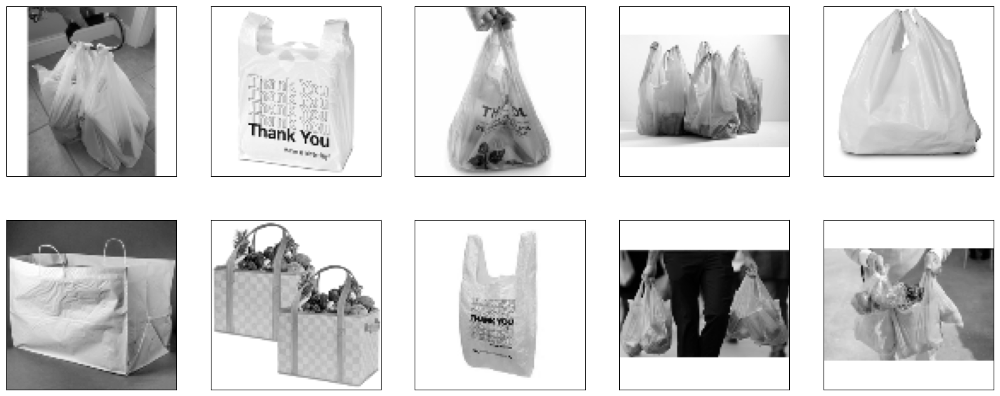

In [ ]:
plt.figure(figsize=(20, 8))

for i in range(10):
  plt.subplot(2, 5, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.imshow(x[i], cmap='gray')

Se observa que son muy pocos datos por etiqueta (sólo 500), por ende, se decide realizar una agrupación de las imágenes de acuerdo con la división estándar de las canecas de separación de residuos en la fuente. De esta manera se agrupan las categorías, se reducen el número de etiquetas inicial, que era de 30, a 5. Esto aumenta la cantidad de datos por grupo, lo que a la postre contribuirá a que el modelo tenga más información de la que atenerse para entrenar y, finalmente, ser más robusto y eficaz.

In [ ]:
import gc
gc.collect()

82087

# **prueba**

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.image as mpimg

ImportError: cannot import name 'ResNeXt50' from 'tensorflow.keras.applications' (/usr/local/lib/python3.10/dist-packages/keras/api/_v2/keras/applications/__init__.py)

In [ ]:
image_size = 100

In [ ]:
train_set=[]

In [ ]:
num_images1=len(image_paths)

Pre procesamiento de las imagenes

In [ ]:
for i in range(num_images1):
    imagen = mpimg.imread(image_paths[i])  # Leer la imagen desde la ruta
    etiqueta = labels[i]  # Obtener la etiqueta correspondiente

    imagen=cv2.resize(imagen, (image_size, image_size))#redimensionando la imagen
    imagen= imagen.reshape(image_size,image_size,3)

    train_set.append([imagen,etiqueta])

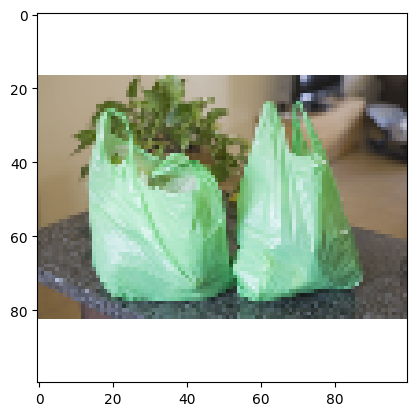

In [ ]:
plt.imshow(train_set[25][0])

In [ ]:
x=[] #imagen
y=[] #etiqueta

for imagen, etiqueta in train_set:
    x.append(imagen)
    y.append(etiqueta)

In [ ]:
x= np.array(x)

In [ ]:
y= np.array(y)

In [ ]:
np.unique(y)

array(['aerosol_cans', 'aluminum_food_cans', 'aluminum_soda_cans',
       'cardboard_boxes', 'cardboard_packaging', 'clothing',
       'coffee_grounds', 'disposable_plastic_cutlery', 'eggshells',
       'food_waste', 'glass_beverage_bottles',
       'glass_cosmetic_containers', 'glass_food_jars', 'magazines',
       'newspaper', 'office_paper', 'paper_cups', 'plastic_cup_lids',
       'plastic_detergent_bottles', 'plastic_food_containers',
       'plastic_shopping_bags', 'plastic_soda_bottles', 'plastic_straws',
       'plastic_trash_bags', 'plastic_water_bottles', 'shoes',
       'steel_food_cans', 'styrofoam_cups', 'styrofoam_food_containers',
       'tea_bags'], dtype='<U26')

In [ ]:
from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical

num_classes = 30

# Step 1: Encode string labels to integers
label_encoder = LabelEncoder()
y_integer_encoded = label_encoder.fit_transform(y)

# Step 2: Convert integer labels to one-hot encoding
y_encoded = to_categorical(y_integer_encoded, num_classes=num_classes)

In [ ]:
y_encoded[650:660]

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0

In [ ]:

# Dividir los datos en conjuntos de entrenamiento, validación y prueba
x_train, x_temp, y_train, y_temp = train_test_split(x, y_encoded, test_size=0.4, random_state=42)
x_val, x_test, y_val, y_test = train_test_split(x_temp, y_temp, test_size=0.5, random_state=42)

In [ ]:
x_train.shape

(9000, 100, 100, 3)

In [ ]:
y_train.shape

(9000, 30)

In [ ]:
x_test.shape

(3000, 100, 100, 3)

In [ ]:
x_val.shape

(3000, 100, 100, 3)

Aumento de datos

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
# Aumentación de datos
datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.25,
    height_shift_range=0.25,
    shear_range=0.22,
    zoom_range=0.28,
    horizontal_flip=True,
    vertical_flip=True,
)

In [ ]:
# Ajustar el generador de datos al conjunto de entrenamiento
datagen.fit(x_train)

In [ ]:
# Cargar el modelo ResNet50 preentrenado
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(100, 100, 3))

94765736/94765736 [==============================] - 3s 0us/step


In [ ]:
from tensorflow.keras.callbacks import TensorBoard

In [ ]:
%load_ext tensorboard

In [ ]:
 %tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
#from itertools import dropwhile

# Añadir nuevas capas de salida
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024, activation='relu')(x)
#x = Dropout(0.5)(x)
#x = Dense(512, activation='softmax')(x)
x = Dropout(0.5)(x)
predictions = Dense(30, activation='softmax')(x)  # 30 clases de basura

# Modelo final
model = Model(inputs=base_model.input, outputs=predictions)

# Congelar las capas del modelo base
for layer in base_model.layers:
    layer.trainable = False

# Compilar el modelo
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
tensorboardmodel = TensorBoard(log_dir='logs/model')

# Entrenar el modelo
history = model.fit(
    datagen.flow(x_train, y_train, batch_size=32),
    validation_data=(x_val, y_val),
    epochs=10,  # Incrementar el número de épocas para observar el comportamiento con Early Stopping
    callbacks=[early_stopping, tensorboardmodel]
)

Epoch 1/10
282/282 [==============================] - 51s 152ms/step - loss: 3.4464 - accuracy: 0.0392 - val_loss: 3.3852 - val_accuracy: 0.0433
Epoch 2/10
282/282 [==============================] - 38s 134ms/step - loss: 3.3877 - accuracy: 0.0411 - val_loss: 3.3777 - val_accuracy: 0.0660
Epoch 3/10
282/282 [==============================] - 39s 137ms/step - loss: 3.3818 - accuracy: 0.0473 - val_loss: 3.3776 - val_accuracy: 0.0443
Epoch 4/10
282/282 [==============================] - 39s 137ms/step - loss: 3.3777 - accuracy: 0.0470 - val_loss: 3.3564 - val_accuracy: 0.0603
Epoch 5/10
114/282 [===========>..................] - ETA: 19s - loss: 3.3752 - accuracy: 0.0491

KeyboardInterrupt: 

In [ ]:
# Descongelar algunas capas del modelo base y entrenar nuevamente
for layer in base_model.layers:
    layer.trainable = True

model.compile(optimizer=tf.keras.optimizers.Adam(1e-5), loss='categorical_crossentropy', metrics=['accuracy'])

history_fine_tune = model.fit(
    x_train, y_train,
    validation_data=(x_val, y_val),
    epochs=20,
    batch_size=32,
    callbacks=[early_stopping, tensorboardmodel]
)




Epoch 1/20
282/282 [==============================] - 79s 131ms/step - loss: 3.8073 - accuracy: 0.0718 - val_loss: 14.8596 - val_accuracy: 0.0347
Epoch 2/20
282/282 [==============================] - 34s 121ms/step - loss: 2.8410 - accuracy: 0.2362 - val_loss: 5.6282 - val_accuracy: 0.0540
Epoch 3/20
282/282 [==============================] - 34s 121ms/step - loss: 2.2281 - accuracy: 0.4117 - val_loss: 2.8664 - val_accuracy: 0.2987
Epoch 4/20
282/282 [==============================] - 32s 113ms/step - loss: 1.7605 - accuracy: 0.5311 - val_loss: 1.5559 - val_accuracy: 0.6043
Epoch 5/20
282/282 [==============================] - 34s 122ms/step - loss: 1.3948 - accuracy: 0.6121 - val_loss: 1.2357 - val_accuracy: 0.6687
Epoch 6/20
282/282 [==============================] - 35s 122ms/step - loss: 1.1060 - accuracy: 0.6959 - val_loss: 1.0864 - val_accuracy: 0.7003
Epoch 7/20
282/282 [==============================] - 32s 114ms/step - loss: 0.8908 - accuracy: 0.7527 - val_loss: 0.9788 - val_a

In [ ]:
# Evaluar el modelo en el conjunto de prueba
test_loss, test_accuracy = model.evaluate(x_test, y_test)
print(f'Test accuracy: {test_accuracy}')

# Guardar el modelo entrenado
model.save('modelo_clasificacion_basura.h5')

94/94 [==============================] - 3s 31ms/step - loss: 0.8034 - accuracy: 0.7770
Test accuracy: 0.7770000100135803


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
import cv2
import numpy as np
import joblib

def preprocess_image(image_path):
    # Cargar la imagen desde el archivo
    image = cv2.imread(image_path)

    # Verificar si la imagen se cargó correctamente
    if image is None:
        raise ValueError("La imagen no se pudo cargar. Verifica la ruta del archivo.")

    # Redimensionar la imagen a 100x100
    resized_image = cv2.resize(image, (100, 100))

    # Convertir la imagen a un array de numpy y normalizar los valores dividiendo por 256
    normalized_image = resized_image / 256.0

    # Redimensionar la imagen a (1, 100, 100, 3)
    reshaped_image = np.reshape(normalized_image, (1, 100, 100, 3))

    return reshaped_image

joblib.dump(preprocess_image, 'procesador_imagen.joblib')


['procesador_imagen.joblib']

94/94 [==============================] - 4s 27ms/step
              precision    recall  f1-score   support

           0       0.88      0.83      0.86        96
           1       0.64      0.49      0.55       114
           2       0.74      0.76      0.75       102
           3       0.61      0.54      0.58       109
           4       0.48      0.53      0.50        85
           5       0.71      0.81      0.76       106
           6       0.82      0.92      0.87       100
           7       0.93      0.91      0.92        94
           8       0.92      0.85      0.89       122
           9       0.93      0.90      0.92       120
          10       0.81      0.68      0.74        93
          11       0.81      0.89      0.85       106
          12       0.77      0.81      0.79        90
          13       0.84      0.88      0.86        96
          14       0.69      0.72      0.70        92
          15       0.59      0.65      0.62        89
          16       0.73    

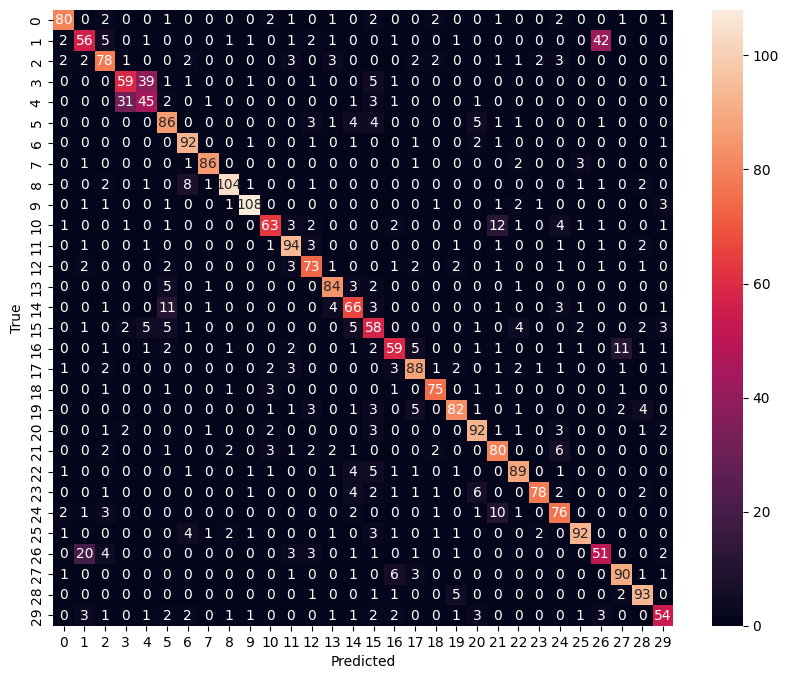

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Obtener predicciones del conjunto de prueba
y_pred = model.predict(x_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

# Imprimir reporte de clasificación
print(classification_report(y_true, y_pred_classes))

# Matriz de confusión
conf_matrix = confusion_matrix(y_true, y_pred_classes)


plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [ ]:
model.save('modelo_completo.h5')


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


/content/modelo_completo.h5

In [ ]:
"""Papel y Cartón:

cardboard_boxes
cardboard_packaging
magazines
newspaper
office_paper
paper_cups

Residuos Aprovechables (Plástico, Vidrio, Metales):

disposable_plastic_cutlery
plastic_cup_lids
plastic_detergent_bottles
plastic_food_containers
plastic_shopping_bags
plastic_soda_bottles
plastic_straws
plastic_trash_bags
plastic_water_bottles
glass_beverage_bottles
glass_cosmetic_containers
glass_food_jars
aerosol_cans
aluminum_food_cans
aluminum_soda_cans
steel_food_cans

Residuos Orgánicos Aprovechables:

coffee_grounds
eggshells
food_waste
tea_bags

Residuos No Aprovechables:

styrofoam_cups
styrofoam_food_containers
plastic_trash_bags
plastic_straws

Reutilizables
clothing
shoes

SyntaxError: incomplete input (<ipython-input-105-3ddedad564f7>, line 1)

In [ ]:
papel_y_carton = ['cardboard_boxes', 'cardboard_packaging', 'magazines', 'newspaper', 'office_paper', 'paper_cups']

residuos_aprovechables = ['disposable_plastic_cutlery', 'plastic_cup_lids',
                          'plastic_detergent_bottles', 'plastic_food_containers', 'plastic_shopping_bags', 'plastic_soda_bottles',
                          'plastic_straws', 'plastic_trash_bags', 'plastic_water_bottles', 'glass_beverage_bottles',
                          'glass_cosmetic_containers', 'glass_food_jars', 'aerosol_cans', 'aluminum_food_cans', 'aluminum_soda_cans',
                          'steel_food_cans']

residuos_orgánicos_aprovechables = ['coffee_grounds', 'eggshells', 'food_waste', 'tea_bags']

residuos_no_aprovechables = ['styrofoam_cups', 'styrofoam_food_containers', 'plastic_trash_bags', 'plastic_straws']

reutilizables = ['clothing', 'shoes']

In [ ]:
Y = []
for label in y:
    if label in papel_y_carton:
        Y.append('papel_y_carton')
    elif label in residuos_aprovechables:
        Y.append('residuos_aprovechables')
    elif label in residuos_orgánicos_aprovechables:
        Y.append('residuos_orgánicos_aprovechables')
    elif label in residuos_no_aprovechables:
        Y.append('residuos_no_aprovechables')
    elif label in reutilizables:
        Y.append('reutilizables')
    else:
        Y.append('otros')

print(Y)

['papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_carton', 'papel_y_

In [ ]:
y= np.array(Y)

In [ ]:
y[650:660]

array(['residuos_no_aprovechables', 'residuos_no_aprovechables',
       'residuos_no_aprovechables', 'residuos_no_aprovechables',
       'residuos_no_aprovechables', 'residuos_no_aprovechables',
       'residuos_no_aprovechables', 'residuos_no_aprovechables',
       'residuos_no_aprovechables', 'residuos_no_aprovechables'],
      dtype='<U32')

## **Entrenamiento del modelo**

In [ ]:
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping


In [ ]:
modelCNN = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (5,5), activation='relu', input_shape=(100, 100, 1)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(64, (5,5), activation='relu', input_shape=(100, 100, 1)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(128, (5,5), activation='relu', input_shape=(100, 100, 1)),
    tf.keras.layers.MaxPooling2D(2, 2),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(250, activation='relu'),
    tf.keras.layers.Dense(5, activation='softmax'),
])

modelCNN2 = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (5,5), activation='relu', input_shape=(100, 100, 1)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(64, (5,5), activation='relu', input_shape=(100, 100, 1)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(128, (5,5), activation='relu', input_shape=(100, 100, 1)),
    tf.keras.layers.MaxPooling2D(2, 2),

    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(250, activation='relu'),
    tf.keras.layers.Dense(5, activation='softmax'),
])

In [ ]:
modelCNN.compile(optimizer='adam',
                 loss='categorical_crossentropy',
                 metrics=['accuracy'])

modelCNN2.compile(optimizer='adam',
                 loss='categorical_crossentropy',
                 metrics=['accuracy'])

In [ ]:
modelCNN.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 96, 96, 32)        832       
                                                                 
 max_pooling2d (MaxPooling2  (None, 48, 48, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 44, 44, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 22, 22, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 18, 18, 128)       204928    
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 9, 9, 128)         0

In [ ]:
modelCNN2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 96, 96, 32)        832       
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 48, 48, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_4 (Conv2D)           (None, 44, 44, 64)        51264     
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 22, 22, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_5 (Conv2D)           (None, 18, 18, 128)       204928    
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 9, 9, 128)        

Train

In [ ]:
from tensorflow.keras.callbacks import TensorBoard

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
 %tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 2754), started 0:52:43 ago. (Use '!kill 2754' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
np.unique(y)

array(['papel_y_carton', 'residuos_aprovechables',
       'residuos_no_aprovechables', 'residuos_orgánicos_aprovechables',
       'reutilizables'], dtype='<U32')

In [ ]:
from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical

# Assuming you have 5 classes
num_classes = 5

# Step 1: Encode string labels to integers
label_encoder = LabelEncoder()
y_integer_encoded = label_encoder.fit_transform(y)

# Step 2: Convert integer labels to one-hot encoding
y_encoded = to_categorical(y_integer_encoded, num_classes=num_classes)

In [ ]:
tensorboardCNN = TensorBoard(log_dir='logs/cnn')

modelCNN.fit(x, y_encoded,
                batch_size=32,
                validation_split=0.15,
                epochs=100,
                callbacks=[tensorboardCNN])

ValueError: `validation_split` is only supported for Tensors or NumPy arrays, found following types in the input: [<class 'keras.src.engine.keras_tensor.KerasTensor'>]

In [ ]:
tensorboardCNN2 = TensorBoard(log_dir='logs/cnn2')

modelCNN2.fit(x, y_encoded,
                batch_size=32,
                validation_split=0.15,
                epochs=100,
                callbacks=[tensorboardCNN2])

In [ ]:
def train_val_test_split(x, shuffle=True, ):

In [ ]:
batch_size = 8
n_epochs  = 20
learn_rate = 0.0001

In [ ]:
model = tf.keras.Sequential()
model.add(tf.keras.Input(shape=(100, 100, 1)))

# 1st Convolution layer - Primera capa de convolución
model.add(tf.keras.layers.Conv2D(
    filters=32, kernel_size=(7, 7),
    strides=(1, 1), padding='same',
    data_format='channels_last',
    name='conv_1', activation=None))
# 1st Pooling layer - Primera capa de agrupación
model.add(tf.keras.layers.MaxPool2D(
    pool_size=(2, 2), name='pool_1'))

In [ ]:
model.add(tf.keras.layers.Conv2D(
    filters=64, kernel_size=(5, 5),
    strides=(1, 1), padding='same',
    name='conv_2', activation='relu'))       # Aplica la función de activación ReLu.
# 2nd Pooling layer - Segunda capa de agrupación
model.add(tf.keras.layers.MaxPool2D(
    pool_size=(2, 2), name='pool_2'))

In [ ]:
# Flattened full layer - Capa completa aplanada
model.add(tf.keras.layers.Flatten())
# fully connected layer - capa completamente conectada
model.add(tf.keras.layers.Dense(
    units=1024, name='fc_1',
    activation='relu'))

In [ ]:
# Dropout layer - Capa de abandono
model.add(tf.keras.layers.Dropout(
    rate=0.5))

In [ ]:
# Output layer - Capa de salida
model.add(tf.keras.layers.Dense(
    units=5, name='fc_2',
    activation='softmax'))

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = learn_rate),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

In [ ]:
model.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate = learn_rate),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

In [ ]:
model.summary()

In [ ]:
history = model.fit(x, y_encoded, epochs=n_epochs,
                    batch_size= 32,
                    validation_split=0.15,
                    shuffle=True)

In [ ]:
x.shape

In [ ]:
y.shape